# Aggregate TFIDF

DS 5001 Text as Data

# Overview

Recall Luhn's (1958) representation of the problem:

<img src="luhn.png"/>

In this notebook, we look at ways to approximate Luhn's significance curve using the ideas we learned in this module.

# Set Up

## Import

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly_express as px

In [2]:
sns.set()

## Config

Change this to match the location of your data files.

In [3]:
import configparser
config = configparser.ConfigParser()
config.read("../../../env.ini")
data_home = config['DEFAULT']['data_home'] 
output_dir = config['DEFAULT']['output_dir']
data_prefix = 'austen-melville'

In [4]:
OHCO = ['book_id', 'chap_id', 'para_num', 'sent_num', 'token_num']
bags = dict(
    SENTS = OHCO[:4],
    PARAS = OHCO[:3],
    CHAPS = OHCO[:2],
    BOOKS = OHCO[:1]
)

In [5]:
# bag = 'BOOKS'
bag = 'CHAPS'

# Prepare the data

## Import tables

In [ ]:
LIB = pd.read_csv(f"{output_dir}/{data_prefix}-LIB.csv").set_index('book_id')
TOKEN = pd.read_csv(f'{output_dir}/{data_prefix}-CORPUS.csv').set_index(OHCO).dropna()
VOCAB = pd.read_csv(f'{output_dir}/{data_prefix}-VOCAB-{bag}.csv').set_index('term_str').dropna()
BOW = pd.read_csv(f'{output_dir}/{data_prefix}-BOW-{bag}.csv').set_index(bags[bag]+['term_str'])
DTCM = pd.read_csv(f'{output_dir}/{data_prefix}-DTCM-{bag}.csv').set_index(bags[bag]) 
TFIDF = pd.read_csv(f'{output_dir}/{data_prefix}-TFIDF-{bag}.csv').set_index(bags[bag])

# Apply aggregates to VOCAB

In [40]:
VOCAB['tfidf_mean'] = TFIDF.mean() 
VOCAB['tfidf_sum'] = TFIDF.sum()

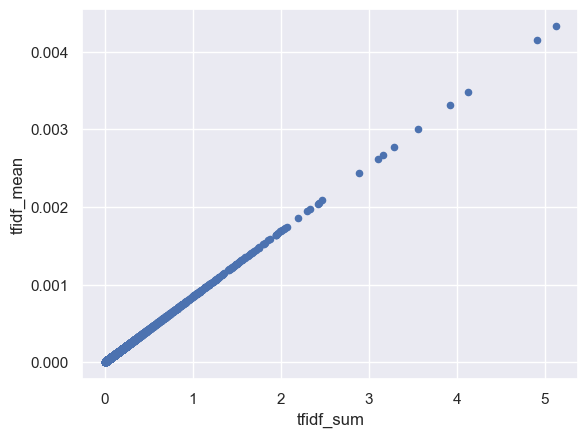

In [42]:
VOCAB.plot.scatter('tfidf_sum', 'tfidf_mean');

These are the same, so we'll just use one of them (`tfidf_mean`).

## Add DFIDF and DH

Instead of aggregating TFIDF values, try estimating the their weights over documents directly.

Do this in two ways:

1. Based on a variation on the TF-IDF formula.
2. Just estimate the entropy of terms over documents.

In [56]:
VOCAB['dfidf'] = VOCAB.df * VOCAB.idf
VOCAB['dp'] = VOCAB.df / len(DTCM)
VOCAB['di'] = np.log2(1/VOCAB.dp)
VOCAB['dh'] = VOCAB.dp * VOCAB.di

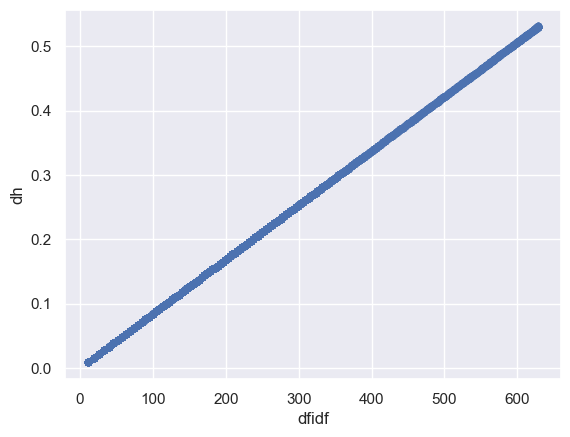

In [65]:
VOCAB.plot.scatter('dfidf', 'dh');

These are the same, so we'll just use one of them (`dh`).

# Visualize

Try to pick the best aggregate statistic -- `tfidf_mean` vs `dh`.

In [72]:
VOCAB.sample(25).sort_values('dh', ascending=False)[['max_pos', 'tfidf_mean', 'dh']].head(15)\
    .style.background_gradient(cmap='YlGnBu')

,max_pos,tfidf_mean,dh
term_str,,,
escape,VB,0.000241,0.368156
notion,NN,0.000144,0.217913
settling,VBG,0.000078,0.146995
genial,JJ,0.000126,0.134273
humane,NN,0.000073,0.134273
granite,NN,0.000064,0.058133
confidentially,RB,0.000025,0.053474
converting,VBG,0.000024,0.043733
query,NN,0.000034,0.027715


## Information and TFIDF Mean 

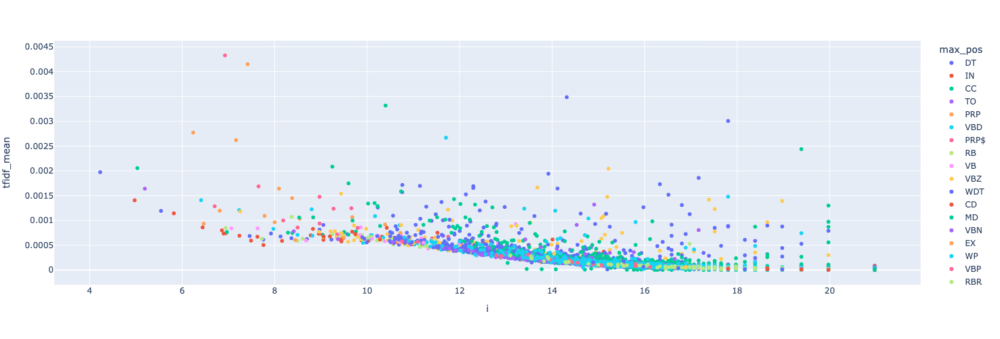

In [73]:
px.scatter(VOCAB.reset_index(), x='i', y='tfidf_mean', 
           hover_name='term_str', hover_data=['n'], color='max_pos', 
           log_x=False, log_y=False, height=500, width=700)

## Information and DH

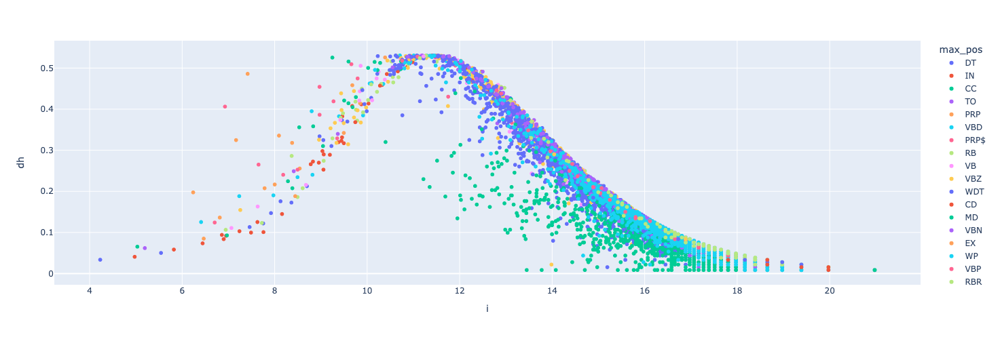

In [52]:
px.scatter(VOCAB.reset_index(), x='i', y='dh', 
           hover_name='term_str', hover_data=['n'], 
           color='max_pos', height=500, width=800)

## Luhn's Graph

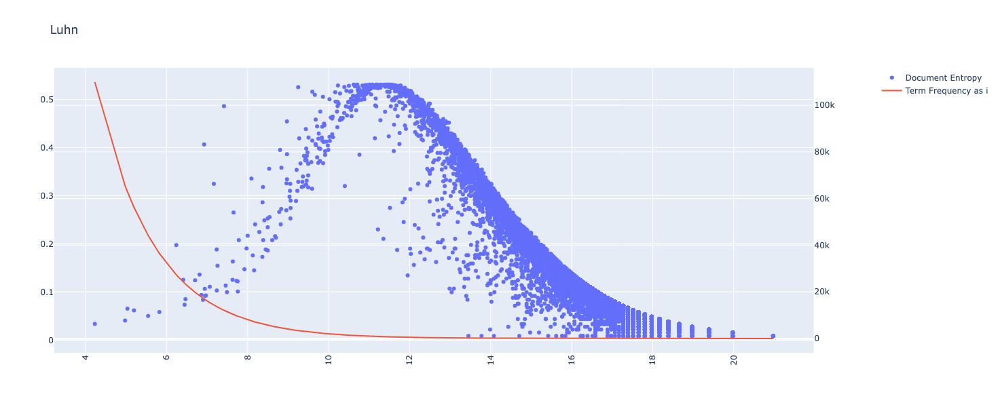

In [75]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from plotly.offline import plot, iplot, init_notebook_mode
init_notebook_mode(connected=False)

V = VOCAB.reset_index()

trace1 = go.Scatter(
     x=V.i2, 
     y=V.dh, 
     name='Document Entropy',
     mode='markers'
)

trace2 = go.Scatter(
    x=V.i2,
    y=V.n,
    name='Term Frequency as i'
)

fig = make_subplots(specs=[[{"secondary_y": True}]])
fig.add_trace(trace1)
fig.add_trace(trace2, secondary_y=True)
fig['layout'].update(height = 600, width = 1000, 
      title = "Luhn",
      xaxis=dict(tickangle=-90))
iplot(fig)

# Reduce VOCAB

We select Significant Terms based on maximizing `DH`.

In [114]:
VOCAB.dh.describe()

count    40278.000000
mean         0.055214
std          0.085012
min          0.008617
25%          0.008617
50%          0.021837
75%          0.058133
max          0.530736
Name: dh, dtype: float64

In [139]:
thresh = VOCAB.dh.quantile(.9).round(3)

In [140]:
thresh

0.144

In [141]:
SIGS = VOCAB[VOCAB.dh > thresh]

In [142]:
len(SIGS)

3965

In [148]:
SIGS.loc[SIGS.max_pos_group == 'NN'].sort_values('dh', ascending=False)[['term_rank', 'n', 'max_pos', 'df', 'dh']].head(10)

,term_rank,n,max_pos,df,dh
term_str,,,,,
home,227,954,NN,437,0.530736
manner,272,748,NN,427,0.530626
times,275,737,NNS,447,0.530568
oh,169,1311,NN,447,0.530568
rest,296,696,NN,420,0.530379
people,260,822,NNS,419,0.530332
others,264,782,NNS,455,0.530238
hands,265,771,NNS,413,0.529990
moment,212,1067,NN,460,0.529944


In [143]:
SIGS[['max_pos', 'n', 'i', 'dh']].head(25).style.background_gradient(cmap='YlGnBu')

,max_pos,n,i,dh
term_str,,,,
i,PRP,27280,6.237927,0.197509
her,PRP$,16927,6.926444,0.406211
you,PRP,14347,7.165021,0.324766
had,VBD,13671,7.234652,0.188265
is,VBZ,13463,7.256771,0.154618
she,PRP,12059,7.415660,0.485912
have,VB,10377,7.632381,0.163143
my,PRP$,10237,7.651978,0.265068
him,PRP,9352,7.782424,0.207666


A reduced `TFIDF` table.

In [154]:
TFIDF[SIGS.index]

i       her       you       had        is       she  \
book_id chap_id                                                               
105     1        0.000000  0.010998  0.000168  0.006178  0.000332  0.010495   
        2        0.000235  0.011763  0.000000  0.003109  0.000354  0.014887   
        3        0.004579  0.001770  0.002175  0.001468  0.001599  0.002913   
        4        0.000000  0.011822  0.000000  0.005949  0.000000  0.020860   
        5        0.004888  0.007746  0.004910  0.002177  0.000525  0.010781   
...                   ...       ...       ...       ...       ...       ...   
34970   110      0.002468  0.003815  0.000000  0.000333  0.001061  0.001396   
        111      0.003638  0.004053  0.001220  0.000607  0.001449  0.002542   
        112      0.000352  0.000000  0.000000  0.000665  0.000265  0.000000   
        113      0.003052  0.003303  0.001160  0.001153  0.002296  0.000000   
        114      0.002158  0.003892  0.000000  0.000340  0.001082  0.004271   

                     have        my       him     which  ...  bewildered  \
book_id chap_id                                          ...               
105     1        0.000848  0.000000  0.000845  0.001194  ...         0.0   
        2        0.001316  0.000000  0.000624  0.001337  ...         0.0   
        3        0.001504  0.001296  0.001042  0.000698  ...         0.0   
        4        0.001233  0.000000  0.000819  0.001096  ...         0.0   
        5        0.002457  0.001207  0.000593  0.000645  ...         0.0   
...                   ...       ...       ...       ...  ...         ...   
34970   110      0.000282  0.000508  0.000000  0.000752  ...         0.0   
        111      0.000513  0.001541  0.002500  0.000913  ...         0.0   
        112      0.000000  0.000000  0.002243  0.000250  ...         0.0   
        113      0.000000  0.005276  0.000648  0.000000  ...         0.0   
        114      0.000575  0.002072  0.002291  0.000000  ...         0.0   

                 conversing  unjust  flattered  settling  avail  retain  \
book_id chap_id                                                           
105     1               0.0     0.0   0.000000  0.000000    0.0     0.0   
        2               0.0     0.0   0.000000  0.002595    0.0     0.0   
        3               0.0     0.0   0.000000  0.000000    0.0     0.0   
        4               0.0     0.0   0.000000  0.000000    0.0     0.0   
        5               0.0     0.0   0.001542  0.000000    0.0     0.0   
...                     ...     ...        ...       ...    ...     ...   
34970   110             0.0     0.0   0.000000  0.000000    0.0     0.0   
        111             0.0     0.0   0.000000  0.000000    0.0     0.0   
        112             0.0     0.0   0.000000  0.000000    0.0     0.0   
        113             0.0     0.0   0.000000  0.000000    0.0     0.0   
        114             0.0     0.0   0.000000  0.000000    0.0     0.0   

                 enjoying  temptation  appearances  
book_id chap_id                                     
105     1             0.0         0.0     0.000000  
        2             0.0         0.0     0.000000  
        3             0.0         0.0     0.000000  
        4             0.0         0.0     0.002838  
        5             0.0         0.0     0.000000  
...                   ...         ...          ...  
34970   110           0.0         0.0     0.000000  
        111           0.0         0.0     0.000000  
        112           0.0         0.0     0.000000  
        113           0.0         0.0     0.000000  
        114           0.0         0.0     0.000000  

[1185 rows x 3965 columns]

# Save Work

In [153]:
save_path = f"{output_dir}/{data_prefix}"
SIGS.to_csv(f'{save_path}-SIGS-{bag}.csv')
TFIDF[SIGS.index].to_csv(f'{save_path}-TFIDF_REDUCED-{bag}.csv')